In [25]:
import os
import matplotlib.pyplot as plt
import librosa
import numpy as np
from sklearn.decomposition import PCA
import glob
import pandas as pd
import plotly.express as px

### Получение информации о наборе данных

In [17]:
TRAIN_AUDIO_PATH = '../DataSet/train/audio'
folders = os.listdir(TRAIN_AUDIO_PATH)
classes_count = len(folders)
print('Количество классов - ' + str(classes_count))

Количество классов - 31


### Подсчет экземпляров каждого класса

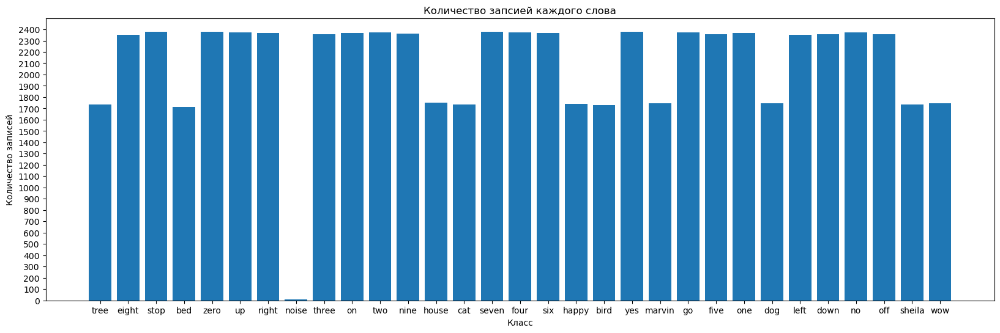

In [18]:
audio_counts = []
for folder in folders:
    audio_files = os.listdir(TRAIN_AUDIO_PATH + '/' + folder)
    audio_counts.append(len(audio_files))

plt.figure(figsize=(20, 6))

# Строим столбчатую диаграмму, где:
# - X-ось — порядковый номер класса
# - Y-ось — количество записей в классе
plt.bar(range(len(audio_counts)), audio_counts)

plt.title('Количество запсией каждого слова')
plt.xlabel('Класс')
plt.ylabel('Количество записей')
plt.yticks(range(0, max(audio_counts) + 100, 100))
plt.xticks(range(len(audio_counts)), [class_name for class_name in folders])
plt.savefig(f'../DataSetInfo/classes_nums.png', format='png')
plt.show()
plt.close()

### Подсчет средних FFT и спектрограмм для каждого класса

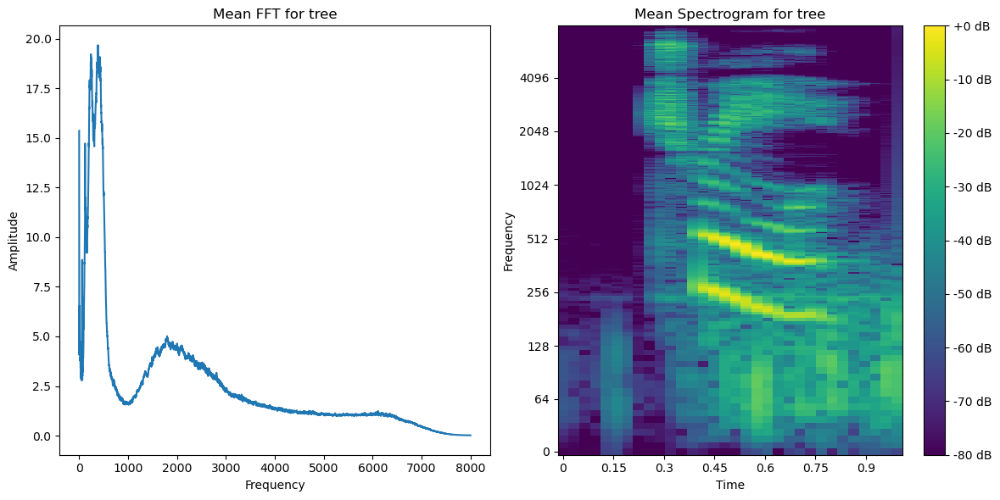

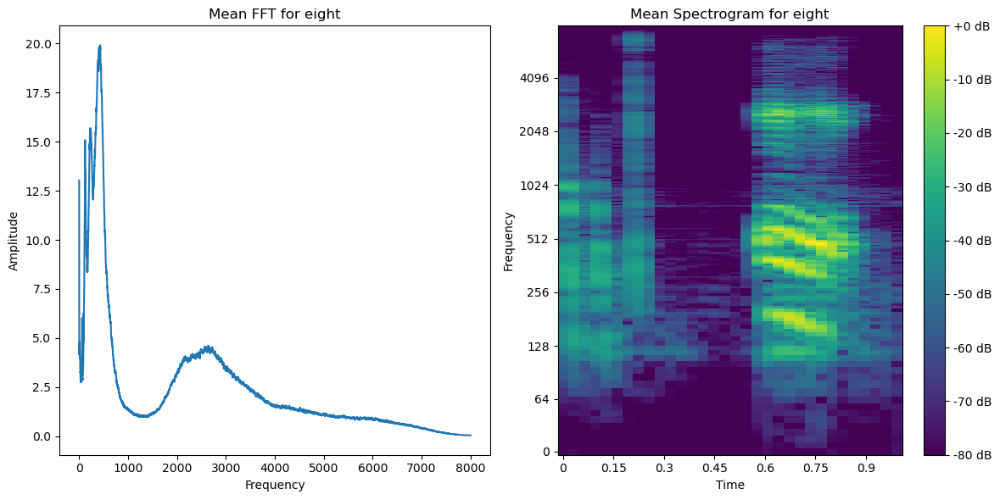

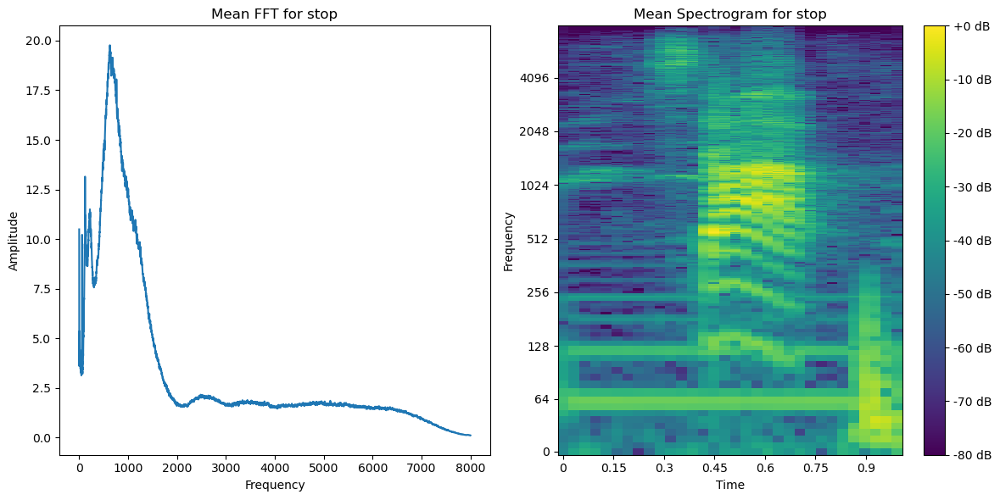

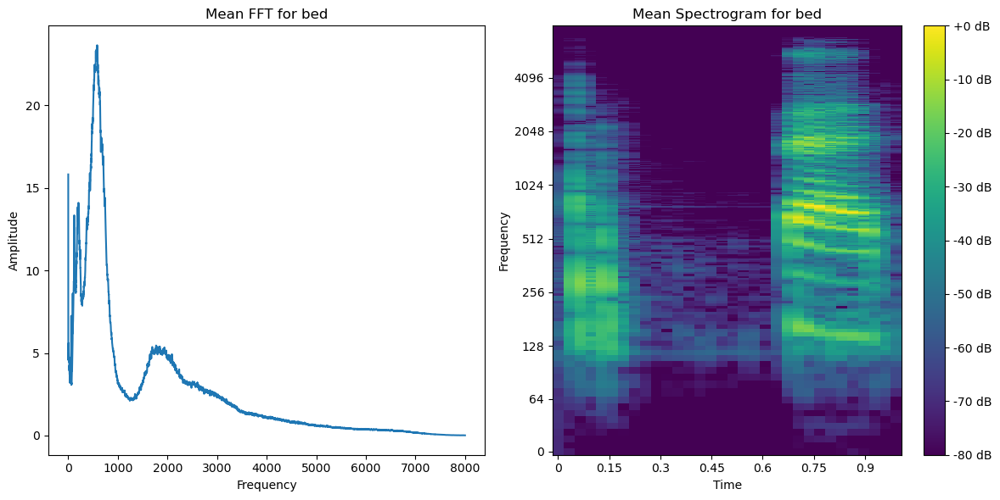

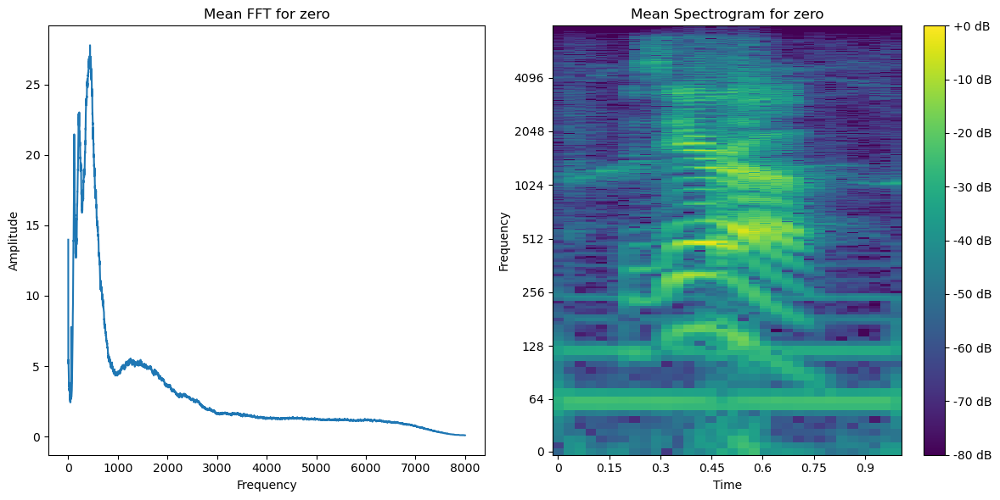

...

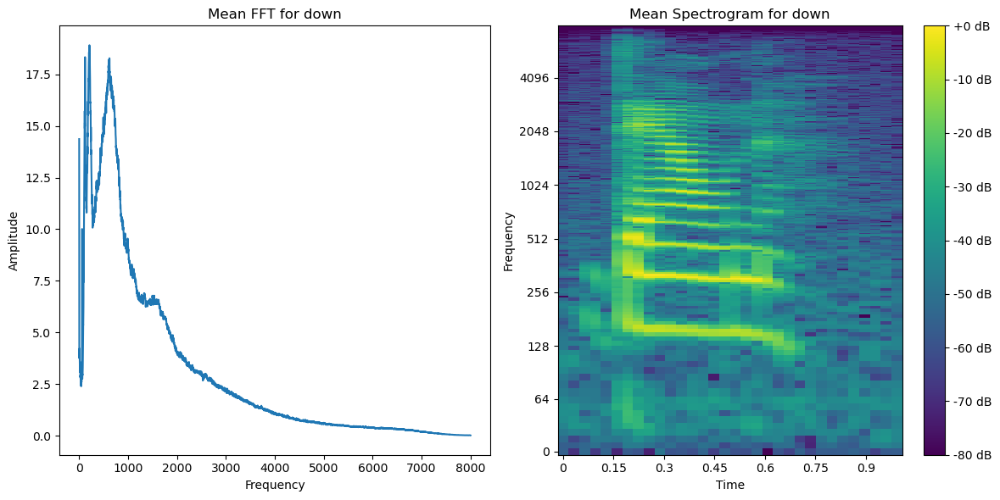

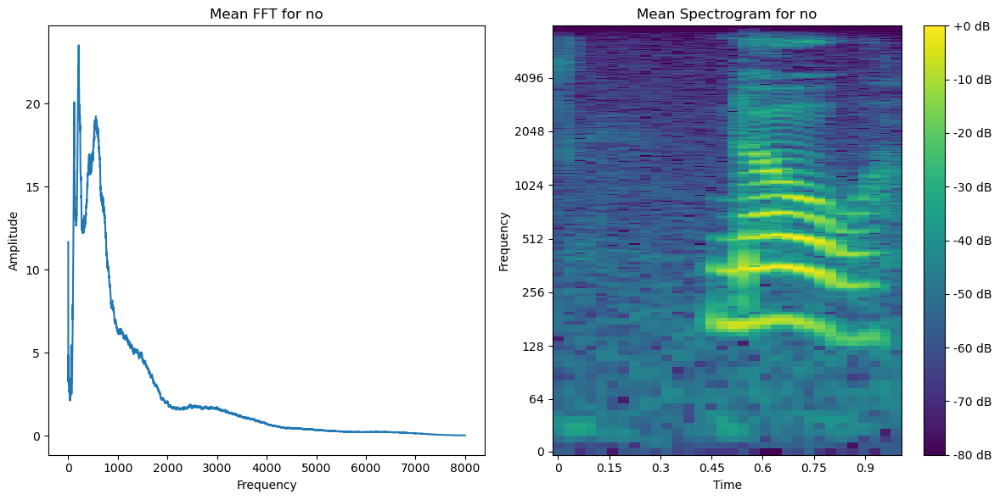

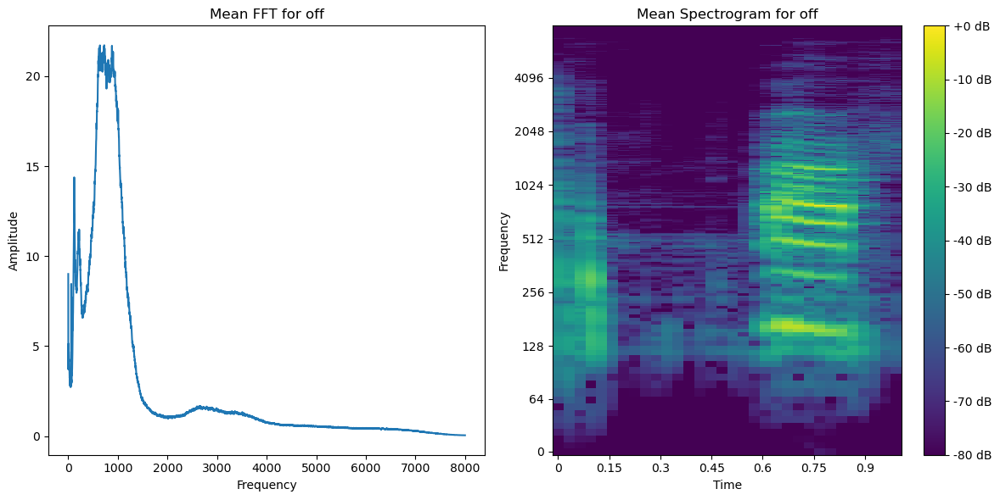

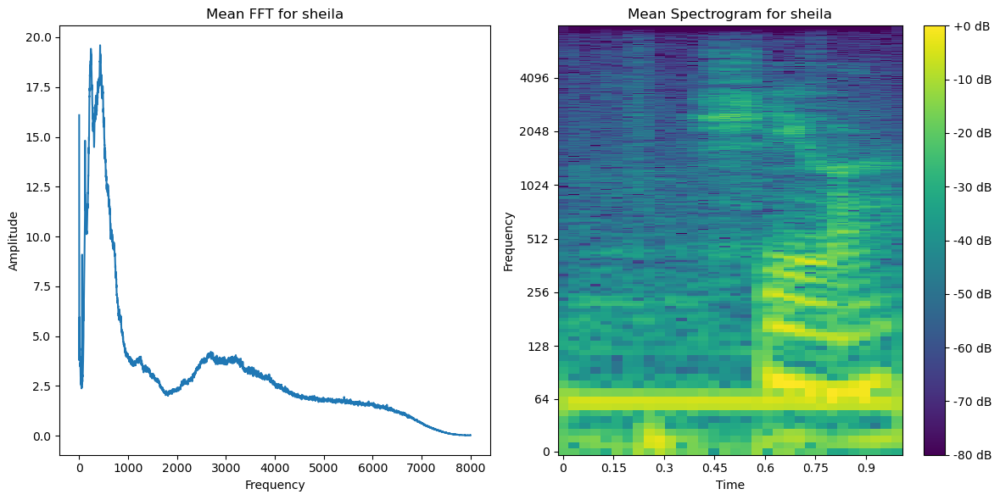

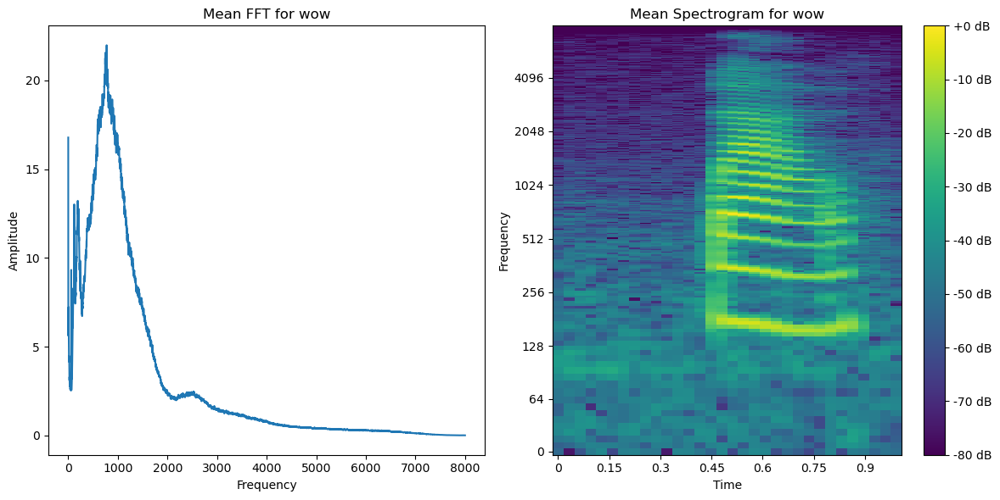

In [19]:
def calculate_mean_fft_and_spectrogram(audio_dir):
    word_dirs = [d for d in os.listdir(audio_dir) if os.path.isdir(os.path.join(audio_dir, d))]
    
    for word in word_dirs:
        word_path = os.path.join(audio_dir, word)
        fft_list = [] # Список для хранения преобразованных в частотную область сигналов (FFT)
        spectrogram_list = [] # Список для хранения спектрограмм
        max_fft_length = 0 # Для хранения максимальной длины FFT среди файлов
        max_spectrogram_length = 0 # Для хранения максимальной ширины спектрограммы (по времени)
        
        for file in os.listdir(word_path):
            if file.endswith('.wav'):
                file_path = os.path.join(word_path, file)
                audio, sample_rate = librosa.load(file_path, sr=None) # Загружаем аудио

                # Вычисляем амплитудный спектр с помощью БПФ (FFT)
                fft = np.abs(np.fft.fft(audio))[:len(audio) // 2] # Оставляем только первую половину спектра (положительные частоты)
                fft_list.append(fft) # Добавляем в список
                max_fft_length = max(max_fft_length, len(fft)) # Обновляем максимальную длину FFT

                # Вычисляем спектрограмму с помощью STFT
                spectrogram = np.abs(librosa.stft(audio))
                spectrogram_list.append(spectrogram) # Добавляем в список спектрограмм
                max_spectrogram_length = max(max_spectrogram_length, spectrogram.shape[1]) # Обновляем максимальную ширину спектрограммы

        # Приводим все FFT к одной длине, заполняя нулями недостающие значения
        fft_list = [np.pad(fft, (0, max_fft_length - len(fft)), mode='constant') for fft in fft_list]
        
         # Приводим все спектрограммы к одной ширине, заполняя нулями недостающие значения
        spectrogram_list = [np.pad(spectrogram, ((0, 0), (0, max_spectrogram_length - spectrogram.shape[1])), mode='constant') for S in spectrogram_list]

        
        mean_fft = np.mean(fft_list, axis=0) # Вычисляем среднее значение FFT для данного класса
        mean_spectrogram = np.mean(spectrogram_list, axis=0) # Вычисляем среднюю спектрограмму для данного класса
        
        plt.figure(figsize=(12, 6))
        plt.subplot(1, 2, 1)
        plt.plot(mean_fft)
        plt.title(f'Mean FFT for {word}')
        plt.xlabel('Frequency')
        plt.ylabel('Amplitude')
        
        plt.subplot(1, 2, 2)
        librosa.display.specshow(librosa.amplitude_to_db(mean_spectrogram, ref=np.max),
                                 sr=sample_rate, x_axis='time', y_axis='log', cmap='viridis')
        plt.title(f'Mean Spectrogram for {word}')
        plt.colorbar(format='%+2.0f dB')
        plt.xlabel('Time')
        plt.ylabel('Frequency')
        
        plt.tight_layout()
        plt.savefig(f'../DataSetInfo/{word}_mean_fft_and_spectrogram.png', format='png')
        plt.show()
        plt.close()

calculate_mean_fft_and_spectrogram(TRAIN_AUDIO_PATH)

### Применение PCA для анализа аномалий в каждом класса

In [27]:
def process_audio_directory(directory):
    files = glob.glob(os.path.join(TRAIN_AUDIO_PATH, directory, '*.wav'))
    fft_data, file_names = [], []  # Списки для хранения спектров и имен файлов

    for file_path in files:
        audio, sample_rate = librosa.load(file_path, sr=None) # Загружаем аудио

         # Если запись короче одной секунды, дополняем ее нулями
        if len(audio) < sample_rate:
            audio = np.pad(audio, (0, sample_rate - len(audio)), mode='constant')

        # Вычисляем FFT и берем только первую половину спектра
        fft_values = np.abs(np.fft.fft(audio))[:len(audio) // 2]
        fft_data.append(fft_values) # Добавляем спектр в список
        file_names.append(os.path.relpath(file_path, TRAIN_AUDIO_PATH)) # Сохраняем относительный путь к файлу

    df = pd.DataFrame(fft_data, index=file_names) # Преобразуем список спектров в DataFrame

    df = (df - df.mean()) / df.std() # Нормализация данных: вычитаем среднее и делим на стандартное отклонение

    return df


def visualize_pca(data, title):
    # Применяем метод главных компонент (PCA) для уменьшения размерности до 3 компонент
    pca = PCA(n_components=3)
    reduced_data = pca.fit_transform(data)

    # Создаем DataFrame с результатами PCA
    df_pca = pd.DataFrame(reduced_data, columns=['PC1', 'PC2', 'PC3'], index=data.index)
    df_pca['File'] = df_pca.index

    # Создаем 3D-график рассеяния с Plotly
    fig = px.scatter_3d(df_pca, x='PC1', y='PC2', z='PC3', title=title, hover_data=['File'])
    fig.write_html(f'../DataSetInfo/3d_PCA_{title}.html') # Сохраняем график в HTML-файл
    fig.show()


for category in os.listdir(TRAIN_AUDIO_PATH):
    category_path = os.path.join(TRAIN_AUDIO_PATH, category)
    if os.path.isdir(category_path) and category != 'noise':
        df_fft = process_audio_directory(category)
        visualize_pca(df_fft, category)